In [29]:
import pandas as pd
import matplotlib.pyplot as plt

In [30]:
#pip install pandas_ta

In [31]:
import pandas_ta as ta

In [32]:
import random
import math
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

In [5]:
# Everything concerning USDTRY pair is done here, after testing the models CHECK THIS PART!
bist_daily = pd.read_csv("datasets/bist_100_daily.csv")
usdtry_daily = pd.read_csv('datasets/USDTRY_daily.csv')
usdtry_daily = usdtry_daily[["Date","USDTRY_Close"]]
usdtry_daily["Date"]=pd.to_datetime(usdtry_daily["Date"])
bist_daily["Date"] = pd.to_datetime(bist_daily["Date"])
bist_daily = bist_daily.merge(usdtry_daily, how='inner',on="Date")


# Extract the number of rows and columns by using the shape of the data.
numRows,numColumns = bist_daily.shape
# Extract the time interval.
last_date, first_date = bist_daily.iloc[0].Date, bist_daily.iloc[-1].Date
# Check the availability of the data.
na_cols = bist_daily.columns[bist_daily.isna().any()].tolist()

# Print the information.
print(f"There are {numRows} rows and {numColumns} columns in the initial dataset.")
print(f"The data represents the time frame between the dates '{last_date}' and '{first_date}'.")
if not na_cols:
    print("There are no NA rows.")
else:
    print(f"Columns in the dataset which include NA rows: {na_cols}.")
# Convert columns to numeric values
column_names = ["Price", "Open", "High", "Low"]
for column in column_names:
    bist_daily[column] = bist_daily[column].str.replace(',', '')
    bist_daily[column] = pd.to_numeric(bist_daily[column])
# CONVERT TO DATETIME FORMAT AND SORT DATA BY DATE
bist_daily.Date = pd.to_datetime(bist_daily.Date)
bist_daily.sort_values(by="Date", ignore_index=True,inplace=True)
bist_daily.set_index(pd.DatetimeIndex(bist_daily["Date"]), inplace=True)
bist_daily.rename(columns={"Price": "close"},inplace=True)
# Calculate Returns and append to the df DataFrame
# CUMLOGRET_1 and CUMPCTRET_1 are added (NaN values exists)
bist_daily.ta.log_return(cumulative=True, append=True)
bist_daily.ta.percent_return(cumulative=True, append=True)
# Returns a list of indicators and utility functions (to check in future)
ind_list = bist_daily.ta.indicators(as_list=True)
# RSI_14, MACD_12_26_9, MACDh_12_26_9 and MACDs_12_26_9 are added (NaN values exists)
bist_daily.ta.rsi(append=True)
bist_daily.ta.macd(append=True)
# SMA values are added (use ta in the future)
sma_values = [5, 10, 15] 
for i in sma_values:
    bist_daily['SMA'+str(i)] = bist_daily['close'].rolling(window=i).mean()
# Remove all NaN value rows
bist_daily.dropna(inplace=True)
bist_daily

There are 4285 rows and 8 columns in the initial dataset.
The data represents the time frame between the dates '2019-12-02 00:00:00' and '2000-01-05 00:00:00'.
There are no NA rows.


,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38.20M,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60.08M,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53.29M,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33.31M,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44.39M,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1.04B,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970.54M,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1.81B,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


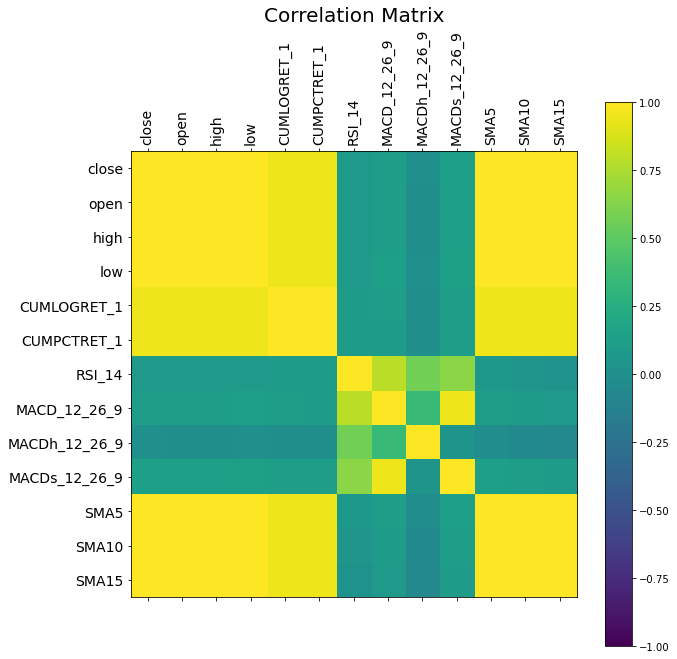

In [6]:
# Visualize the correlation matrix.
fig = plt.figure(figsize=(10,10)) 
ax = fig.add_subplot(111) # 1x1 grid, first subplot.
fig.colorbar(ax.matshow(bist_daily.corr(), vmin=-1, vmax=1)) 
ticks = np.arange(len(bist_daily.corr().columns))
ax.tick_params(axis='x', which='major', labelsize=14, rotation=90)
ax.tick_params(axis='y', which='major', labelsize=14, rotation=0)
ax.set_xticks(ticks)
ax.set_yticks(ticks)
ax.set_xticklabels(bist_daily.corr().columns)
ax.set_yticklabels(bist_daily.corr().columns)
plt.title("Correlation Matrix", fontsize=20)
plt.show()

{1: 2938, 2: 308, 3: 775, 4: 125, 5: 64, 6: 15, 7: 10, 10: 3, 11: 3, 12: 2, 28: 1, 29: 2, 31: 4, 60: 1}


<BarContainer object of 14 artists>

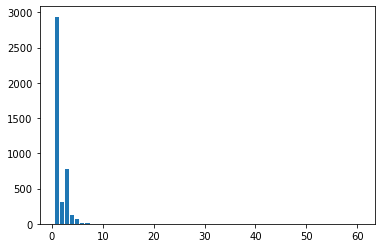

In [7]:
diff = [] 
for date1, date2 in zip(bist_daily["date"][:-1], bist_daily["date"][1:]): 
    diff.append((date2-date1).days) 
unique, counts = np.unique(np.asarray(diff), return_counts=True) 
count_dict = dict(zip(unique, counts)) 
print(count_dict) 
plt.bar(unique,counts)

In [8]:
# edit Vol. column

from operator import itemgetter

vols = bist_daily['Vol.'].to_list()
#[vol[-1] for vol in vols]
#list(filter(lambda vol: "-" in vol,enumerate(vols)))

indexToRemove = bist_daily.iloc[list(map(itemgetter(0),filter(lambda vol: "-" in vol,enumerate(vols))))].index
bist_daily.drop(indexToRemove,inplace=True)
bist_daily['Vol.'] = bist_daily['Vol.'].apply(
    lambda x: float(x[:-1])*(10**6) if x[-1]=="M" else (float(x[:-1])*(10**9) if x[-1]=="B" else "ERROR")).astype("int")
bist_daily

,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38200000,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60080000,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53290000,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33310000,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44390000,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1040000000,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970540000,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1810000000,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


In [9]:
# seeding an arbitrary number to get same results in multiple runs
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print("Seed:", manualSeed)

Seed: 999


In [10]:
# getting number of GPUs from cuda
ngpu = torch.cuda.device_count()
print("Count of available GPUs:", ngpu)

Count of available GPUs: 1


In [11]:
# printing the name of available GPUs
for i in range(ngpu):
    print("GPU {}: {}".format(i+1, torch.cuda.get_device_name(i)))

GPU 1: GeForce RTX 2060


In [12]:
# batch size for the training
batch_size = 64

# optimizer rates
optimizer_betas = (0.9, 0.999)
learning_rate = 5.125e-4

# number of epochs
num_epochs = 100000

# evaluate after evaluation_epoch_num epochs
evaluation_epoch_num = 500

# decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [13]:
class TimeseriesDataset(Dataset):
    def __init__(self, data_frame, sequence_length=2):
        self.data = torch.tensor(data_frame.values)
        self.sequence_length = sequence_length

    def __len__(self):
        return self.data.shape[0] - self.sequence_length + 1

    def __getitem__(self, index):
        return self.data[index: index + self.sequence_length].float()
    
    # Non-overlapping series
    # def __getitem__(self, index):
    #     return self.data[index * self.sequence_length: (index+1) * self.sequence_length]

In [14]:
# create pytorch dataset from the pandas DataFrame

# TODO: Convert change(%) and Volume columns to numeric values
columns_used_in_training = ["close", "open", "high", "low", "CUMLOGRET_1", "RSI_14", "MACD_12_26_9", "SMA5"]
# input dimension of the generator
data_dimension = len(columns_used_in_training)
# sequence length of input data
sequence_length = 7

train_data, rest_data = train_test_split(bist_daily[columns_used_in_training], test_size=0.2, shuffle=False)

scaler = MinMaxScaler()
scaler.fit(train_data)
train_data[train_data.columns] = scaler.transform(train_data)
rest_data[rest_data.columns] = scaler.transform(rest_data)

validation_data, test_data = train_test_split(rest_data, test_size=0.5, shuffle=False)

train_dataset = TimeseriesDataset(train_data, sequence_length)
test_dataset = TimeseriesDataset(test_data, sequence_length)
validation_dataset = TimeseriesDataset(validation_data, sequence_length)

# create the dataloader
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_dataloader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)
real_data_sample = next(iter(train_dataloader))
print("Real data sample shape:", real_data_sample.shape)

Real data sample shape: torch.Size([64, 7, 8])


In [15]:
class Generator(nn.Module):
    def __init__(self, hidden_size):
        super(Generator, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, dropout=0.2, batch_first=True)
        self.linear = nn.Linear(hidden_size, data_dimension)
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        lstm_output, hidden_cell = self.lstm(input_sequences)
        res = self.linear(hidden_cell[0][-1])
        res = res.view(res.shape[0], 1, -1)
        return res

In [16]:
class Discriminator(nn.Module):
    def __init__(self, hidden_size):
        super(Discriminator, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, dropout=0.2, batch_first=True)
        self.linear = nn.Sequential(
            nn.Linear(hidden_size, 1),
            nn.Sigmoid() 
        )
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        lstm_output, hidden_cell = self.lstm(input_sequences)
        res = self.linear(hidden_cell[0][-1])
        res = res.view(res.shape[0], 1, -1)
        return res

In [17]:
def model_rmse(model, dataloader, epoch, plot_graph=False, plot_title="Validation Predictions", show_preds=False):
    rmse = 0
    squared_error_list = []
    real_data_list = []
    predicted_data_list = []
    file_title = plot_title.lower().replace(" ", "_")
    for i, sequence_batch in enumerate(dataloader):
        with torch.no_grad():
            real_sequence = sequence_batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            real_values = sequence_batch[:,-1:]
            #  Generate (t+1)th value from first t values
            predicted_values = generator(generator_input_sequence).cpu()
            real_data_list.append(real_values)
            predicted_data_list.append(predicted_values)
    
    real_data = torch.cat(real_data_list, 0)
    predicted_data = torch.cat(predicted_data_list, 0)
    
    # Unscale data
    df_pred = pd.DataFrame(predicted_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_pred_unscaled = pd.DataFrame(scaler.inverse_transform(df_pred),columns=columns_used_in_training)
    df_real = pd.DataFrame(real_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_real_unscaled = pd.DataFrame(scaler.inverse_transform(df_real),columns=columns_used_in_training)
    
    if plot_graph:
        if not os.path.exists('./plots_lstm_disc/'):
            os.makedirs('./plots_lstm_disc/')
        
        for column in columns_used_in_training:
            # TODO: get x values and plot prediction of multiple columns
            fig = plt.figure(figsize=(16,8))
            plt.xlabel("Date")
            plt.ylabel(column)
            plt.title(plot_title + f" -{column}-")
            plt.plot(df_real_unscaled[column],label="Real")
            plt.plot(df_pred_unscaled[column],label="Predicted")
            # plt.ylim(bottom=0)
            plt.legend()
            if show_preds and column == "close":
                plt.show()
            fig.savefig(f'./plots_lstm_disc/{file_title}_plt_{column}_e{epoch}.png')
            plt.close(fig)
    rmse_results = {}
    for column in columns_used_in_training:
        squared_errors = (df_real_unscaled[column] - df_pred_unscaled[column])**2
        rmse = np.sqrt(squared_errors.mean())
        rmse_results[column] = rmse
    return rmse_results

In [18]:
# TODO: weight initialization of models

In [19]:
generator = Generator(hidden_size=data_dimension*2).to(device)
discriminator = Discriminator(hidden_size=data_dimension*2).to(device)
print("Generator and discriminator are initialized")

C:\Users\yildi\anaconda3\lib\site-packages\torch\nn\modules\rnn.py:58: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn("dropout option adds dropout after all but last "


Generator and discriminator are initialized


In [20]:
criterion = nn.BCELoss()
optimizer_generator = optim.Adam(generator.parameters(), lr=learning_rate, betas=optimizer_betas)
optimizer_discriminator = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=optimizer_betas)

real_label = 1.
fake_label = 0.

In [21]:
if not os.path.exists('./models_lstm_disc/'):
    os.makedirs('./models_lstm_disc/')

In [ ]:
best_predictor = None
min_close_rmse = math.inf

evaluation_metrics = {"gen_loss":[], "disc_loss":[], "rmse_values":{}}
for column in columns_used_in_training:
        evaluation_metrics["rmse_values"][column] = []
                      
print("Training is started")
for epoch in range(num_epochs):
    for i, sequence_batch in enumerate(train_dataloader):
            ############################
            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
            ###########################
            ## Training with real batch
            discriminator.zero_grad()
            # Format batch
            real_sequence = sequence_batch.to(device)
            batch_size = real_sequence.size(0)
            real_labels = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # Forward pass real batch through D
            discriminator_output_real = discriminator(real_sequence).view(-1)
            # Calculate loss on all-real batch
            discriminator_error_real = criterion(discriminator_output_real, real_labels)
            # Calculate gradients for D in backward pass
            discriminator_error_real.backward()

            ## Training with fake batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            #  Generate (t+1)th value from first t values
            generated_values = generator(generator_input_sequence)
            fake_labels = torch.full((batch_size,), fake_label, dtype=torch.float, device=device)
            # Concat first t real values and generated (t+1)th values
            generator_result_concat = torch.cat((generator_input_sequence, generated_values.detach()), 1)
            # Classify all fake batch with D
            discriminator_output_fake = discriminator(generator_result_concat).view(-1)
            # Calculate D's loss on the all-fake batch
            discriminator_error_fake = criterion(discriminator_output_fake, fake_labels)
            # Calculate the gradients for this batch
            discriminator_error_fake.backward()
            # Add the gradients from the all-real and all-fake batches
            discriminator_error = discriminator_error_real + discriminator_error_fake
            # Update D
            optimizer_discriminator.step()

            ############################
            # (2) Update G network: maximize log(D(G(z)))
            ###########################
            generator.zero_grad()
            real_labels = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
            # Since we just updated D, perform another forward pass of all-fake batch through D
            generator_result_concat_grad = torch.cat((generator_input_sequence, generated_values), 1)
            discriminator_output_fake = discriminator(generator_result_concat_grad).view(-1)
            # Calculate G's loss based on this output
            generator_error = criterion(discriminator_output_fake, real_labels)
            # Calculate gradients for G
            generator_error.backward()
            # Update G
            optimizer_generator.step()
    if (epoch+1) % evaluation_epoch_num == 0 or epoch+1 == 1:
        rmse_values = model_rmse(generator, validation_dataloader, epoch=(epoch+1), plot_graph=True)
        if rmse_values["close"] < min_close_rmse:
            min_close_rmse = rmse_values["close"]
            best_predictor = epoch+1
        for column in columns_used_in_training:
            evaluation_metrics["rmse_values"][column].append(rmse_values[column])
        evaluation_metrics["gen_loss"].append(generator_error.item())
        evaluation_metrics["disc_loss"].append(discriminator_error.item())
        print('\n[{}/{}]\tDiscriminator Loss: {:.4f}\tGenerator Loss: {:.4f}'
                  .format(epoch+1, num_epochs, discriminator_error.item(), generator_error.item()))
        for col_name, rmse in rmse_values.items():
            print(f"{col_name} RMSE: {rmse:.4f}")
        save_path = os.path.join("./models_lstm_disc/","model_epoch_{}.pt".format(epoch+1))
        torch.save({
            'epoch': epoch+1,
            'generator_model_state_dict': generator.state_dict(),
            'discriminator_model_state_dict': discriminator.state_dict(),
            'optimizer_generator_state_dict': optimizer_generator.state_dict(),
            'optimizer_discriminator_state_dict': optimizer_discriminator.state_dict(),
            'discriminator_loss': discriminator_error,
            'generator_loss': generator_error,
            }, save_path)

Training is started

[1/100000]	Discriminator Loss: 1.3686	Generator Loss: 0.6713
close RMSE: 579.7491
open RMSE: 512.0982
high RMSE: 854.6507
low RMSE: 764.4014
CUMLOGRET_1 RMSE: 1.8025
RSI_14 RMSE: 23.0177
MACD_12_26_9 RMSE: 34.7643
SMA5 RMSE: 567.8883

[500/100000]	Discriminator Loss: 1.3716	Generator Loss: 0.6980
close RMSE: 64.4121
open RMSE: 53.3069
high RMSE: 70.4075
low RMSE: 95.8329
CUMLOGRET_1 RMSE: 0.5256
RSI_14 RMSE: 9.0993
MACD_12_26_9 RMSE: 7.5356
SMA5 RMSE: 58.5176

[1000/100000]	Discriminator Loss: 1.3817	Generator Loss: 0.6942
close RMSE: 61.1487
open RMSE: 36.6449
high RMSE: 70.1297
low RMSE: 89.3274
CUMLOGRET_1 RMSE: 0.1414
RSI_14 RMSE: 5.9853
MACD_12_26_9 RMSE: 7.2648
SMA5 RMSE: 75.2970

[1500/100000]	Discriminator Loss: 1.3915	Generator Loss: 0.6927
close RMSE: 64.4308
open RMSE: 44.1008
high RMSE: 38.3311
low RMSE: 74.2673
CUMLOGRET_1 RMSE: 0.1099
RSI_14 RMSE: 6.3919
MACD_12_26_9 RMSE: 4.2018
SMA5 RMSE: 79.0874

[2000/100000]	Discriminator Loss: 1.3847	Generator L


[18000/100000]	Discriminator Loss: 1.3861	Generator Loss: 0.6932
close RMSE: 39.8869
open RMSE: 40.0689
high RMSE: 35.9648
low RMSE: 54.6931
CUMLOGRET_1 RMSE: 0.0653
RSI_14 RMSE: 7.2982
MACD_12_26_9 RMSE: 2.7399
SMA5 RMSE: 33.2331

[18500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6928
close RMSE: 43.1147
open RMSE: 56.9183
high RMSE: 28.1426
low RMSE: 21.8263
CUMLOGRET_1 RMSE: 0.0676
RSI_14 RMSE: 10.7918
MACD_12_26_9 RMSE: 8.5604
SMA5 RMSE: 14.5996

[19000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6933
close RMSE: 39.6297
open RMSE: 23.2670
high RMSE: 46.1166
low RMSE: 65.0274
CUMLOGRET_1 RMSE: 0.0850
RSI_14 RMSE: 13.2983
MACD_12_26_9 RMSE: 2.7332
SMA5 RMSE: 22.2567

[19500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6931
close RMSE: 41.7265
open RMSE: 25.4174
high RMSE: 25.8257
low RMSE: 26.4590
CUMLOGRET_1 RMSE: 0.1070
RSI_14 RMSE: 11.9401
MACD_12_26_9 RMSE: 8.0440
SMA5 RMSE: 53.9245

[20000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6933
clo


[36000/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6931
close RMSE: 23.1050
open RMSE: 37.2177
high RMSE: 38.1290
low RMSE: 59.5540
CUMLOGRET_1 RMSE: 0.0374
RSI_14 RMSE: 7.5554
MACD_12_26_9 RMSE: 4.7028
SMA5 RMSE: 23.5738

[36500/100000]	Discriminator Loss: 1.3866	Generator Loss: 0.6932
close RMSE: 40.6966
open RMSE: 42.1315
high RMSE: 32.3047
low RMSE: 22.0182
CUMLOGRET_1 RMSE: 0.0384
RSI_14 RMSE: 7.7817
MACD_12_26_9 RMSE: 2.6608
SMA5 RMSE: 16.9975

[37000/100000]	Discriminator Loss: 1.3861	Generator Loss: 0.6927
close RMSE: 25.7022
open RMSE: 16.4639
high RMSE: 18.0065
low RMSE: 18.6019
CUMLOGRET_1 RMSE: 0.0605
RSI_14 RMSE: 8.5801
MACD_12_26_9 RMSE: 1.8355
SMA5 RMSE: 32.5886

[37500/100000]	Discriminator Loss: 1.3864	Generator Loss: 0.6930
close RMSE: 22.9654
open RMSE: 22.4746
high RMSE: 23.2118
low RMSE: 26.9844
CUMLOGRET_1 RMSE: 0.0352
RSI_14 RMSE: 6.2059
MACD_12_26_9 RMSE: 2.4663
SMA5 RMSE: 26.9337

[38000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6933
close 


[54000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6930
close RMSE: 17.4898
open RMSE: 15.1059
high RMSE: 16.5460
low RMSE: 30.3175
CUMLOGRET_1 RMSE: 0.0349
RSI_14 RMSE: 6.2119
MACD_12_26_9 RMSE: 3.9105
SMA5 RMSE: 29.8166

[54500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6934
close RMSE: 26.5442
open RMSE: 40.1336
high RMSE: 44.0214
low RMSE: 29.4953
CUMLOGRET_1 RMSE: 0.0654
RSI_14 RMSE: 5.7683
MACD_12_26_9 RMSE: 3.3767
SMA5 RMSE: 63.0626

[55000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6932
close RMSE: 20.5598
open RMSE: 17.2597
high RMSE: 19.0072
low RMSE: 20.9072
CUMLOGRET_1 RMSE: 0.0263
RSI_14 RMSE: 5.6163
MACD_12_26_9 RMSE: 2.8746
SMA5 RMSE: 17.3036

[55500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6929
close RMSE: 17.6783
open RMSE: 15.8069
high RMSE: 31.1654
low RMSE: 24.5122
CUMLOGRET_1 RMSE: 0.0387
RSI_14 RMSE: 8.4369
MACD_12_26_9 RMSE: 2.7026
SMA5 RMSE: 25.0512

[56000/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6934
close 


[72000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6930
close RMSE: 29.1012
open RMSE: 35.6220
high RMSE: 49.6893
low RMSE: 33.4065
CUMLOGRET_1 RMSE: 0.0456
RSI_14 RMSE: 7.9298
MACD_12_26_9 RMSE: 1.8053
SMA5 RMSE: 18.0951

[72500/100000]	Discriminator Loss: 1.3862	Generator Loss: 0.6931
close RMSE: 32.7414
open RMSE: 18.5126
high RMSE: 19.0640
low RMSE: 22.3048
CUMLOGRET_1 RMSE: 0.0222
RSI_14 RMSE: 6.9179
MACD_12_26_9 RMSE: 3.7398
SMA5 RMSE: 23.2314

[73000/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6930
close RMSE: 24.8726
open RMSE: 19.2365
high RMSE: 21.2557
low RMSE: 24.6103
CUMLOGRET_1 RMSE: 0.0262
RSI_14 RMSE: 7.2498
MACD_12_26_9 RMSE: 4.5097
SMA5 RMSE: 28.0286

[73500/100000]	Discriminator Loss: 1.3863	Generator Loss: 0.6931
close RMSE: 22.1357
open RMSE: 20.1107
high RMSE: 23.8390
low RMSE: 20.5308
CUMLOGRET_1 RMSE: 0.0285
RSI_14 RMSE: 6.4359
MACD_12_26_9 RMSE: 2.1659
SMA5 RMSE: 12.3481

[74000/100000]	Discriminator Loss: 1.3861	Generator Loss: 0.6935
close 

In [23]:
for key, val in evaluation_metrics["rmse_values"].items():
    print(key, ":", val)

close : [579.7491  64.4121  61.1487  64.4308  32.8269  28.3169  35.7515  40.6265
  22.5144  29.7221  21.1597  26.6786  23.3743  37.332   65.2038  26.7752
  43.9223  51.1692  19.3283  20.4363  41.2402  47.6414  30.9652  20.1516
  33.8932  16.6105  35.0706  37.2603  31.9679  32.5646  21.4722  25.2281
  43.129   64.1288  31.1683  54.4055  39.8869  43.1147  39.6297  41.7265
  94.142   36.5686  28.2975  19.448   27.6093  35.6534  23.1358  22.6695
  25.9985  24.0838  20.218   32.4299  30.0627  25.9205  46.1106  24.4927
  45.7657  23.9647  28.3118  26.3424  28.1662  33.6576  24.3442  27.08
  22.6354  30.0327  19.5669  22.9317  22.9038  32.1402  21.5145  18.7474
  23.105   40.6966  25.7022  22.9654  34.4955  52.042   28.0635  29.7965
  50.6598  19.1959  21.746   28.9432  19.5801  21.3134  18.8824  23.0011
  16.7032  17.313   31.0584  30.9383  87.2028  22.6197  19.2569  21.6443
  22.3126  19.9361  21.2517  25.8614  24.6519  23.54    22.1177  25.5079
  16.815   17.9413  23.9912  17.983   17.4898

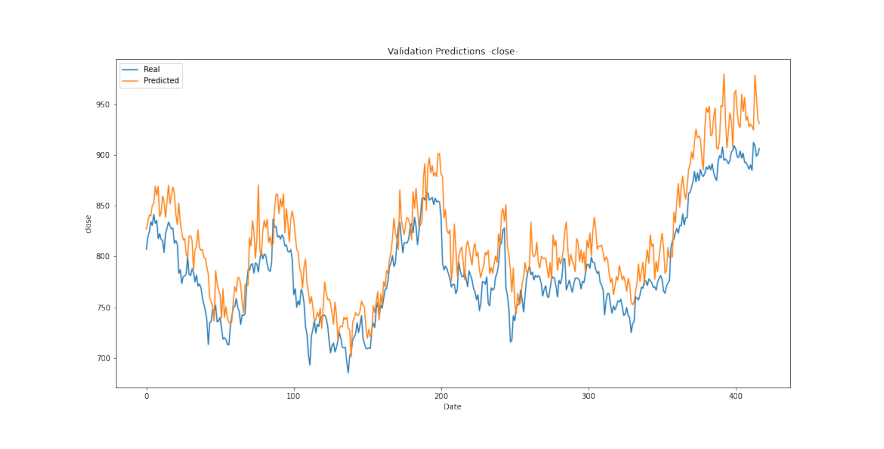

In [34]:
images = []
num_epochs = 85500
for epoch in range(num_epochs):
    if (epoch+1)%evaluation_epoch_num == 0 or epoch == 0 or epoch == (num_epochs-1):
        image_path = os.path.join('./plots_lstm_disc/', f'validation_predictions_plt_close_e{epoch+1}.png')
        image = plt.imread(image_path)
        images.append(image)
#%%capture
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16,8))
plt.axis("off")

all_images = [[plt.imshow(image, animated=True)] for image in images]
plt.rcParams['animation.embed_limit'] = 2**32
ani = animation.ArtistAnimation(fig, all_images, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
fig = plt.figure(figsize=(64,32))
plt.xlabel("Epoch")
plt.ylabel("RMSE")
plt.title("RMSE Values")
epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
# plt.ylim(0, 5)
for column in columns_used_in_training:
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x, y,label=column)
plt.legend()
fig.savefig(f'./plots_lstm_disc/rmse_all.png')
plt.show()
plt.close(fig)

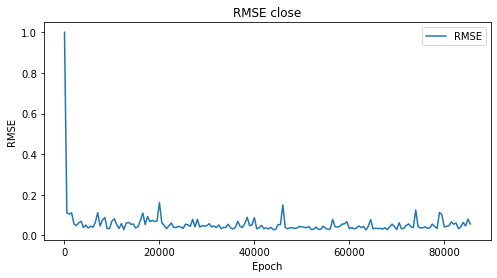

KeyError: 'open'

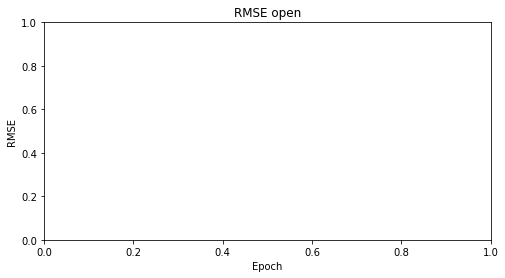

In [25]:
for column in columns_used_in_training:
    fig = plt.figure(figsize=(8,4))
    plt.xlabel("Epoch")
    plt.ylabel("RMSE")
    plt.title(f"RMSE {column}")
    epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
    x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
    # plt.ylim(0, 5)
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x, y,label="RMSE")
    plt.legend()
    fig.savefig(f'./plots_lstm_disc/rmse_{column}.png')
    plt.show()
    plt.close(fig)

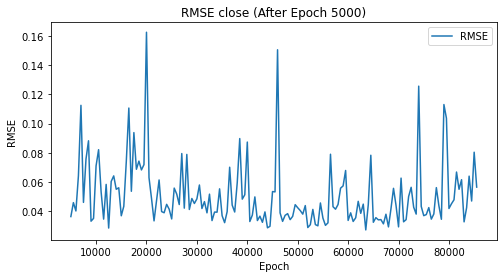

KeyError: 'open'

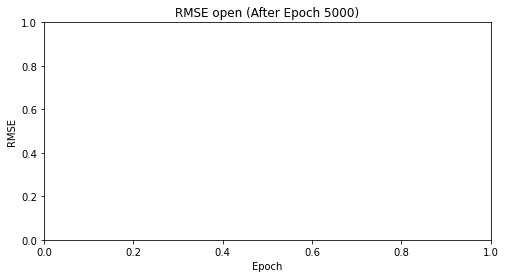

In [28]:
for column in columns_used_in_training:
    fig = plt.figure(figsize=(8,4))
    plt.xlabel("Epoch")
    plt.ylabel("RMSE")
    plt.title(f"RMSE {column} (After Epoch 5000)")
    epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
    x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
    # plt.ylim(0, 5)
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x[10:], y[10:],label="RMSE")
    plt.legend()
    fig.savefig(f'./plots_lstm_disc/rmse_{column}.png')
    plt.show()
    plt.close(fig)

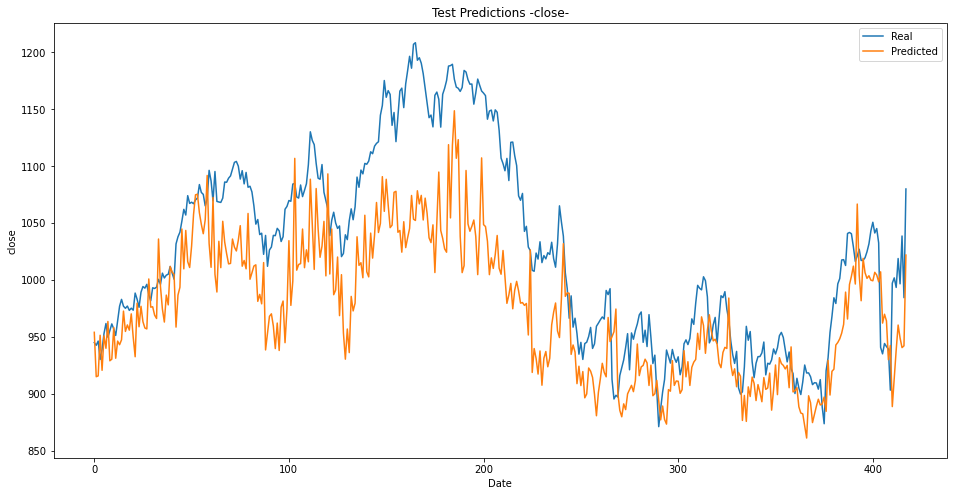

{'close': 66.54564342893991, 'open': 41.51618803308324, 'high': 64.60725612881721, 'low': 64.81243572774075, 'CUMLOGRET_1': 0.05408075493477795, 'RSI_14': 8.66027820291435, 'MACD_12_26_9': 3.5893934923016624, 'SMA5': 55.918302354071606}


In [26]:
checkpoint = torch.load(os.path.join("./models_lstm_disc/","model_epoch_{}.pt".format(best_predictor)))
generator.load_state_dict(checkpoint['generator_model_state_dict'])
rmse_values = model_rmse(generator, test_dataloader, epoch=best_predictor, plot_graph=True, plot_title="Test Predictions", show_preds=True)
print(rmse_values)

In [27]:
best_predictor

63500